# Модуль 2. Диффузионные модели. Часть 2
##  Домашнее задание: реализация обучения диффузионной модели

### Цель домашнего занятия
Научиться реализовывать обучение диффузии под датасет и решить задачу Image Inpainting

### Рекомендации
Задания можно реализовать как с адаптерами так и без. Предполагается, что вы  решите задания с помощью accelerate.

### [6 баллов] Дообучение диффузионной модели.

В этом задании вам предстоит обучить диффузионную модель для решения задачи text-to-image. В предыдущем задании вы уже обучали диффузионную модель, но она была unconditional, то есть генерировала без каких-либо условий. В этот раз вам предлагается обучить свою text-to-image модель на датасете https://huggingface.co/datasets/Norod78/cartoon-blip-captions или на другом понравившемся датасете

---

В этой части задания вам рекомендуется взять код с семинара 4 и адаптировать его под обучение на новом датасете, с учетом того, что в нём содержаться картинки

**Ожидаемый результат**

В качестве результатов модели, от вас требуется предоставить визуализации генераций, полученных от вашей модели и код обучения модели, а также визуальное сравнение качества моделей до и после дообучения. Если не получится дообучить, то можно провести сравнение уже обученных адаптеров (3 балла).

# Импорт необходимых библиотек и зависимостей


In [ ]:
!pip install -q -U datasets diffusers accelerate transformers huggingface_hub
!pip install transformers
!pip install accelerate
!pip install datasets
!pip install diffusers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 493.7/493.7 kB 8.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 65.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 261.4/261.4 kB 31.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 95.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.0/302.0 kB 32.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 15.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 17.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 80.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 105.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 28.3 MB/s eta 0:00:00


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import os
import random
import shutil
from pathlib import Path
from tqdm.auto import tqdm
import math
from textwrap import wrap

from datasets import load_dataset
from datasets import concatenate_datasets

import torch
import torch.nn.functional as F
import torch.utils.checkpoint
from torchvision import transforms

from accelerate import Accelerator
from accelerate.logging import get_logger
logger = get_logger(__name__, log_level="INFO")

from transformers import SchedulerType
from transformers import CLIPTextModel
from transformers import CLIPTokenizer

import diffusers
from diffusers import AutoencoderKL
from diffusers import DDPMScheduler
from diffusers import DiffusionPipeline
from diffusers import UNet2DConditionModel
from diffusers import StableDiffusionPipeline
from diffusers.optimization import get_scheduler

from diffusers.loaders import AttnProcsLayers
from diffusers.models.attention_processor import LoRAAttnProcessor

from google.colab import drive
drive.mount('/content/drive')

from huggingface_hub import notebook_login
notebook_login()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Загрузка и разведочный анализ данных

In [ ]:
# Загрузка датасета
dataSource = load_dataset("Norod78/cartoon-blip-captions")
trainSet = dataSource["train"]

In [ ]:
# Класс для хранения конфигурационных параметров
class ConfigOptions():
    pretrained_model_name_or_path = "runwayml/stable-diffusion-v1-5"
    revision = None
    mixed_precision = 'fp16'
    gradient_accumulation_steps = 1
    outputDirectory = '/content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1'
    allow_tf32 = False
    scale_lr = False
    rank = 4
    train_batch_size = 2
    dataloader_num_workers = 4
    random_flip = False
    max_train_steps = 10000
    num_train_epochs = 5
    lr_scheduler = SchedulerType.COSINE
    lr_warmup_steps = 500
    learning_rate = 1e-4
    resume_from_checkpoint = False
    noise_offset = False
    prediction_type = None
    max_grad_norm = 1.0
    snr_gamma = None
    checkpointing_steps = 2500
    checkpoints_total_limit = None
    seed = 2
    validation_epochs = 1
    show_progress_step = 500

In [ ]:
# Инициализация акселератора
accel = Accelerator(
  gradient_accumulation_steps=ConfigOptions.gradient_accumulation_steps,
  mixed_precision=ConfigOptions.mixed_precision,
  log_with="tensorboard",
  project_dir=os.path.join(ConfigOptions.outputDirectory, "logs")
)

In [ ]:
# Установка типа данных для весов модели
weightType = torch.float32
if accel.mixed_precision == "fp16":
    weightType = torch.float16
elif accel.mixed_precision == "bf16":
    weightType = torch.bfloat16

In [ ]:
# Функция для переноса текста
def wrapTitle(ax, title, max_width):
    words = title.split()
    wrapped_title = ''
    line = ''
    for word in words:
        text_obj = ax.text(0, 1, line + ' ' + word, transform=ax.transAxes)
        if ax.get_window_extent().width * 0.8 > text_obj.get_window_extent().width:
            line += ' ' + word
        else:
            wrapped_title += line + '\n'
            line = word
        text_obj.remove()
    wrapped_title += line
    ax.set_title(wrapped_title)

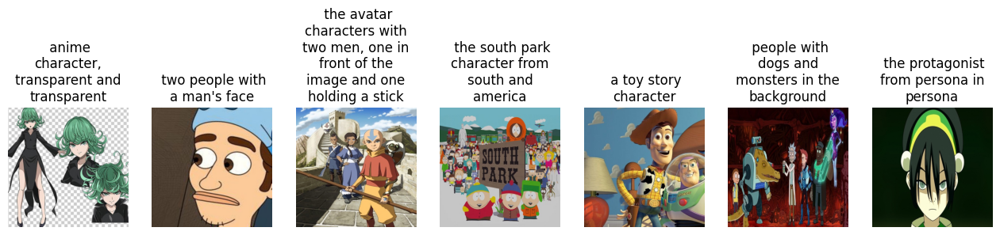

In [ ]:
# Визуализация примеров
fig, axs = plt.subplots(1, 7, figsize=(16, 4))
for i, (image, text) in enumerate(zip(trainSet[:7]["image"], trainSet[:7]["text"])):
    axs[i].imshow(image)
    axs[i].set_axis_off()
    wrapTitle(axs[i], text, max_width=fig.get_window_extent().width)
fig.show()

# Предобработка данных

In [ ]:
# Токенизация текста
captionField = "text"
imageField = "image"
clipTokenizer = CLIPTokenizer.from_pretrained(
        ConfigOptions.pretrained_model_name_or_path, subfolder="tokenizer", revision=ConfigOptions.revision
    )

In [ ]:
# Функция для токенизации подписей
def tokenizeCaptions(sample, is_train=True):
    captions = []
    for caption in sample[captionField]:
        if isinstance(caption, str):
            captions.append(caption)
        elif isinstance(caption, (list, np.ndarray)):
            captions.append(random.choice(caption) if is_train else caption[0])
        else:
            raise ValueError("Caption column should contain either strings or lists of strings.")
    inputs = clipTokenizer(captions, max_length=clipTokenizer.model_max_length, padding="max_length", truncation=True, return_tensors="pt")
    return inputs.input_ids

In [ ]:
# Преобразования для обучающих данных
trainTransforms = transforms.Compose(
        [
            transforms.ToTensor(),
            transforms.Normalize([0.5], [0.5]),
        ]
    )

In [ ]:
# Функция предварительной обработки
def preprocessTrainData(samples):
    images = [image.convert("RGB") for image in samples[imageField]]
    samples["pixel_values"] = [trainTransforms(image) for image in images]
    samples["input_ids"] = tokenizeCaptions(samples)
    return samples

In [ ]:
# Применение преобразований к датасету
with accel.main_process_first():
    processedTrainSet = trainSet.with_transform(preprocessTrainData)

In [ ]:
# Функция для сборки батчей данных
def collateBatch(samples):
    pixelVals = torch.stack([sample["pixel_values"] for sample in samples])
    pixelVals = pixelVals.to(memory_format=torch.contiguous_format).float()
    inputIds = torch.stack([sample["input_ids"] for sample in samples])
    return {"pixel_values": pixelVals, "input_ids": inputIds}

In [ ]:
# Создание DataLoader
trainDataLoader = torch.utils.data.DataLoader(
        processedTrainSet,
        shuffle=True,
        collate_fn=collateBatch,
        batch_size=ConfigOptions.train_batch_size,
        num_workers=ConfigOptions.dataloader_num_workers,
    )

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


# Создание модели

In [ ]:
# Инициализация моделей и шедулера
noiseScheduler = DDPMScheduler.from_pretrained(ConfigOptions.pretrained_model_name_or_path, subfolder="scheduler")
textEncoder = CLIPTextModel.from_pretrained(ConfigOptions.pretrained_model_name_or_path, subfolder="text_encoder", revision=ConfigOptions.revision)
vaeModel = AutoencoderKL.from_pretrained(ConfigOptions.pretrained_model_name_or_path, subfolder="vae", revision=ConfigOptions.revision)
unetModel = UNet2DConditionModel.from_pretrained(ConfigOptions.pretrained_model_name_or_path, subfolder="unet", revision=ConfigOptions.revision)

In [ ]:
# Установка флагов тренировки и перенос на устройство
unetModel.requires_grad_(False)
vaeModel.requires_grad_(False)
textEncoder.requires_grad_(False)
unetModel.to(accel.device, dtype=weightType)
vaeModel.to(accel.device, dtype=weightType)
textEncoder.to(accel.device, dtype=weightType)

CLIPTextModel(
  (text_model): CLIPTextTransformer(
    (embeddings): CLIPTextEmbeddings(
      (token_embedding): Embedding(49408, 768)
      (position_embedding): Embedding(77, 768)
    )
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0-11): 12 x CLIPEncoderLayer(
          (self_attn): CLIPAttention(
            (k_proj): Linear(in_features=768, out_features=768, bias=True)
            (v_proj): Linear(in_features=768, out_features=768, bias=True)
            (q_proj): Linear(in_features=768, out_features=768, bias=True)
            (out_proj): Linear(in_features=768, out_features=768, bias=True)
          )
          (layer_norm1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): QuickGELUActivation()
            (fc1): Linear(in_features=768, out_features=3072, bias=True)
            (fc2): Linear(in_features=3072, out_features=768, bias=True)
          )
          (layer_norm2): LayerNorm((768,), eps=1e

In [ ]:
# Инициализация модели для диффузионного процесса
diffusionModel = DiffusionPipeline.from_pretrained(
  ConfigOptions.pretrained_model_name_or_path,
  net=accel.unwrap_model(unetModel),
  revision=ConfigOptions.revision,
  torch_dtype=weightType,
)

Keyword arguments {'net': UNet2DConditionModel(
  (conv_in): Conv2d(4, 320, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=320, out_features=1280, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=1280, out_features=1280, bias=True)
  )
  (down_blocks): ModuleList(
    (0): CrossAttnDownBlock2D(
      (attentions): ModuleList(
        (0-1): 2 x Transformer2DModel(
          (norm): GroupNorm(32, 320, eps=1e-06, affine=True)
          (proj_in): LoRACompatibleConv(320, 320, kernel_size=(1, 1), stride=(1, 1))
          (transformer_blocks): ModuleList(
            (0): BasicTransformerBlock(
              (norm1): LayerNorm((320,), eps=1e-05, elementwise_affine=True)
              (attn1): Attention(
                (to_q): LoRACompatibleLinear(in_features=320, out_features=320, bias=False)
                (to_k): LoRACompatibleLinear(in_features=320, out_features=320, 

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


In [ ]:
# Перемещение модели на устройство для вычислений
diffusionModel.to(accel.device)

# Отключение прогресс-бара
diffusionModel.set_progress_bar_config(disable=True)

In [ ]:
# Генерация изображений для проверки модели
generatedImages = []
for i in range(4):
  textPrompt = trainSet[i]["text"]
  generatedImg = diffusionModel(textPrompt, num_inference_steps=30, generator=torch.manual_seed(0)).images[0]
  generatedImages.append(generatedImg)

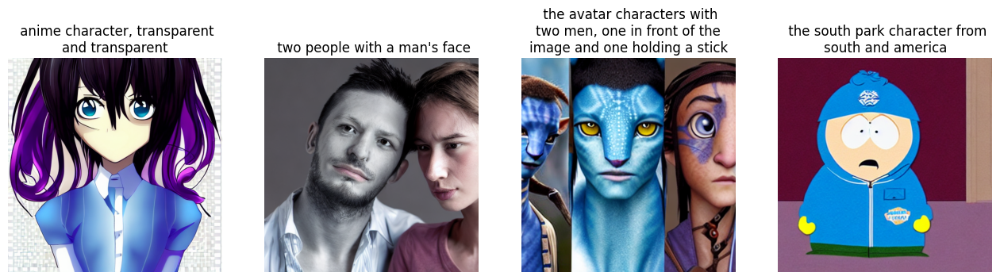

In [ ]:
# Визуализация сгенерированных изображений
fig, axisArr = plt.subplots(1, 4, figsize=(16, 4))
for i, (image, text) in enumerate(zip(generatedImages, trainSet[:4]["text"])):
    axisArr[i].imshow(image)
    axisArr[i].set_axis_off()
    wrapTitle(axisArr[i], text, max_width=fig.get_window_extent().width)
fig.show()

In [ ]:
# Инициализация SD модели
stableDiffModel = StableDiffusionPipeline(
  scheduler=noiseScheduler,
  vae=vaeModel,
  text_encoder=textEncoder,
  tokenizer=clipTokenizer,
  unet=unetModel,
  safety_checker=None,
  feature_extractor=None
)

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [ ]:
# Перемещение модели на устройство
stableDiffModel = stableDiffModel.to(accel.device)

In [ ]:
# Функция для проверки состояния модели
def checkModelState(modelPipeline, seed=0):
  imgList = []
  for i in range(7):
    textPrompt = trainSet[i]["text"]
    generatedImg = modelPipeline(textPrompt, num_inference_steps=30, generator=torch.manual_seed(seed)).images[0]
    imgList.append(generatedImg)

  # Визуализация сгенерированных изображений
  fig, axisArr = plt.subplots(1, 7, figsize=(16, 5))
  for i, (image, text) in enumerate(zip(imgList, trainSet[:7]["text"])):
    axisArr[i].imshow(image)
    axisArr[i].set_axis_off()
    wrapTitle(axisArr[i], text, max_width=fig.get_window_extent().width)
  plt.show()

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

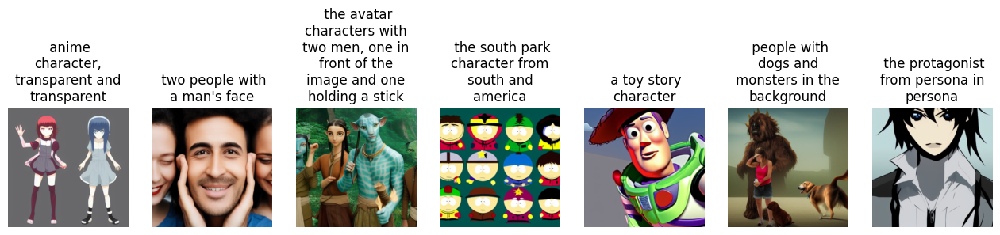

In [ ]:
# Проверка состояния модели
checkModelState(stableDiffModel, seed=ConfigOptions.seed)

In [ ]:
# Очистка ресурсов
del stableDiffModel

# Инициализируем подготовку к обучению модели

In [ ]:
# Получение параметра cross_attention_dim из конфигурации модели UNet
crossAttnDim = unetModel.config.cross_attention_dim

In [ ]:
# Инициализация словаря для LoRA (Low-Rank Attention) процессоров.
# Это словарь, который будет содержать процессоры внимания с низким рангом для различных слоев UNet модели.
loraAttnProcessors = {}

# Цикл по всем ключам в словаре attn_processors модели UNet.
# Каждый ключ соответствует слою внимания в модели.
for procName in unetModel.attn_processors.keys():

    # Определение размерности для cross-attention.
    # Если имя процессора заканчивается на "attn1.processor", то cross_attention_dim устанавливается в None.
    crossAttnSpecific = None if procName.endswith("attn1.processor") else crossAttnDim

    # Определение hidden_size на основе блока в модели UNet, к которому относится процессор.

    # Если процессор находится в "mid_block", то hidden_size берется из последнего элемента списка block_out_channels.
    if procName.startswith("mid_block"):
        hiddenDim = unetModel.config.block_out_channels[-1]

    # Если процессор находится в "up_blocks", то hidden_size определяется на основе номера блока.
    elif procName.startswith("up_blocks"):
        blockID = int(procName[len("up_blocks.")])  # Извлечение номера блока из имени
        hiddenDim = list(reversed(unetModel.config.block_out_channels))[blockID]  # Обращение списка и выбор нужного элемента

    # Если процессор находится в "down_blocks", то hidden_size определяется на основе номера блока.
    elif procName.startswith("down_blocks"):
        blockID = int(procName[len("down_blocks.")])  # Извлечение номера блока из имени
        hiddenDim = unetModel.config.block_out_channels[blockID]  # Выбор нужного элемента из списка

    # Создание экземпляра LoRAAttnProcessor с определенными параметрами и добавление его в словарь.
    loraAttnProcessors[procName] = LoRAAttnProcessor(
        hidden_size=hiddenDim,  # Размер скрытого слоя
        cross_attention_dim=crossAttnSpecific,  # Размерность cross-attention
        rank=ConfigOptions.rank,  # Ранг для аппроксимации матрицы внимания
    )

# Установка созданных LoRA процессоров в модель UNet.
unetModel.set_attn_processor(loraAttnProcessors)

In [ ]:
# Функция для вычисления SNR (Signal-to-Noise Ratio)
def compute_snr(timesteps):
        """
        Computes SNR as per https://github.com/TiankaiHang/Min-SNR-Diffusion-Training/blob/521b624bd70c67cee4bdf49225915f5945a872e3/guided_diffusion/gaussian_diffusion.py#L847-L849
        """
        alphas_cumprod = noiseScheduler.alphas_cumprod
        sqrt_alphas_cumprod = alphas_cumprod**0.5
        sqrt_one_minus_alphas_cumprod = (1.0 - alphas_cumprod) ** 0.5

        sqrt_alphas_cumprod = sqrt_alphas_cumprod.to(device=timesteps.device)[timesteps].float()
        while len(sqrt_alphas_cumprod.shape) < len(timesteps.shape):
            sqrt_alphas_cumprod = sqrt_alphas_cumprod[..., None]
        alpha = sqrt_alphas_cumprod.expand(timesteps.shape)

        sqrt_one_minus_alphas_cumprod = sqrt_one_minus_alphas_cumprod.to(device=timesteps.device)[timesteps].float()
        while len(sqrt_one_minus_alphas_cumprod.shape) < len(timesteps.shape):
            sqrt_one_minus_alphas_cumprod = sqrt_one_minus_alphas_cumprod[..., None]
        sigma = sqrt_one_minus_alphas_cumprod.expand(timesteps.shape)

        # Compute SNR.
        snr = (alpha / sigma) ** 2
        return snr

In [ ]:
# Настройка параметров для вычислений с использованием tf32
if ConfigOptions.allow_tf32:
    torch.backends.cuda.matmul.allow_tf32 = True

# Масштабирование скорости обучения
if ConfigOptions.scale_lr:
    ConfigOptions.learning_rate *= (ConfigOptions.gradient_accumulation_steps * ConfigOptions.train_batch_size * accel.num_processes)

In [ ]:
# Инициализация слоев внимания для оптимизатора
attentionLayers = AttnProcsLayers(unetModel.attn_processors)

In [ ]:
# Создание оптимизатора
opt = torch.optim.AdamW(unetModel.parameters(), lr=ConfigOptions.learning_rate)

In [ ]:
# Вычисление числа шагов обучения и настройка планировщика скорости обучения
overrode_max_train_steps = False
num_update_steps_per_epoch = math.ceil(len(trainDataLoader) / ConfigOptions.gradient_accumulation_steps)
if ConfigOptions.max_train_steps is None:
        ConfigOptions.max_train_steps = ConfigOptions.num_train_epochs * num_update_steps_per_epoch
        overrode_max_train_steps = True

In [ ]:
# Создание планировщика скорости обучения
lr_scheduler = get_scheduler(
        ConfigOptions.lr_scheduler,
        optimizer=opt,
        num_warmup_steps=ConfigOptions.lr_warmup_steps * accel.num_processes,
        num_training_steps=ConfigOptions.max_train_steps * accel.num_processes,
)

In [ ]:
# Подготовка всех компонентов для работы с акселератором
lora_layers, optimizer, train_dataloader, lr_scheduler = accel.prepare(
        attentionLayers, opt, trainDataLoader, lr_scheduler
    )

# Пересчет общего числа шагов обучения и числа эпох на основе текущего размера обучающего набора данных
num_update_steps_per_epoch = math.ceil(len(train_dataloader) / ConfigOptions.gradient_accumulation_steps)
if overrode_max_train_steps:
        ConfigOptions.max_train_steps = ConfigOptionss.num_train_epochs * num_update_steps_per_epoch

ConfigOptions.num_train_epochs = math.ceil(ConfigOptions.max_train_steps / num_update_steps_per_epoch)

In [ ]:
# Инициализация размера общего батча
total_batch_size = ConfigOptions.train_batch_size * accel.num_processes * ConfigOptions.gradient_accumulation_steps

# Инициализация глобального шага и начальной эпохи
global_step = 0
first_epoch = 0

In [ ]:
# Создание индикатора прогресса
progress_bar = tqdm(range(global_step, ConfigOptions.max_train_steps), disable=not accel.is_local_main_process)
progress_bar.set_description("Steps")

  0%|          | 0/10000 [00:00<?, ?it/s]

# Визуализация

/usr/local/lib/python3.10/dist-packages/diffusers/models/attention_processor.py:1402: FutureWarning: `LoRAAttnProcessor` is deprecated and will be removed in version 0.26.0. Make sure use AttnProcessor instead by settingLoRA layers to `self.{to_q,to_k,to_v,to_out[0]}.lora_layer` respectively. This will be done automatically when using `LoraLoaderMixin.load_lora_weights`
  deprecate(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


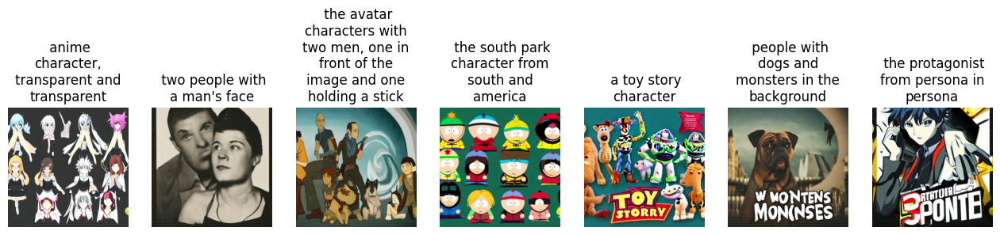

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


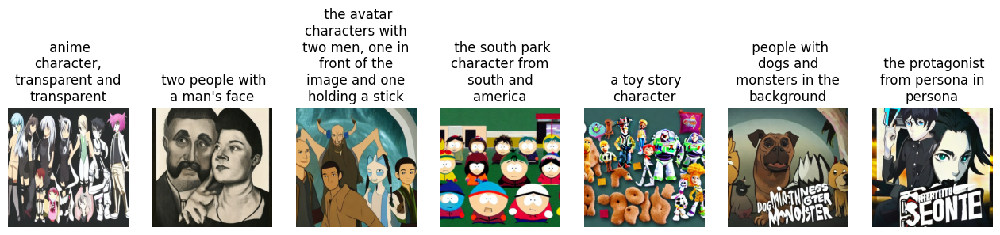

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


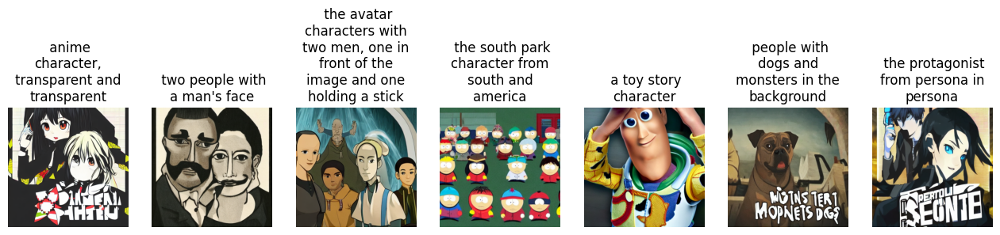

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


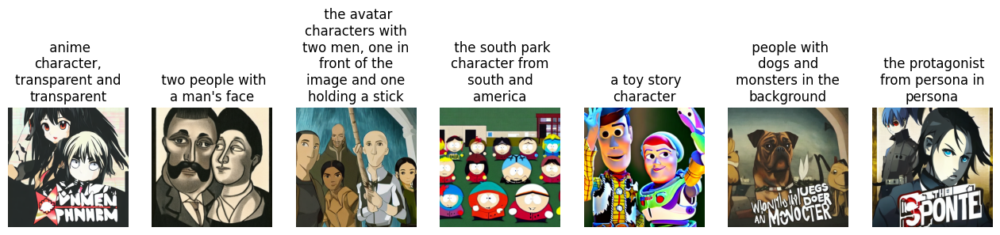

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


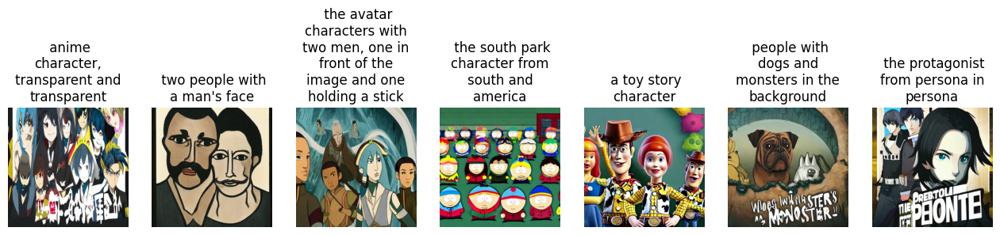

INFO:accelerate.accelerator:Saving current state to /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-2500
INFO:accelerate.checkpointing:Model weights saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-2500/pytorch_model.bin
INFO:accelerate.checkpointing:Optimizer state saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-2500/optimizer.bin
INFO:accelerate.checkpointing:Scheduler state saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-2500/scheduler.bin
INFO:accelerate.checkpointing:Sampler state for dataloader 0 saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-2500/sampler.bin
INFO:accelerate.checkpointing:Gradient scaler state saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-2500/scaler.pt
INFO:accelerate.checkpointing:Random states saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/sav

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


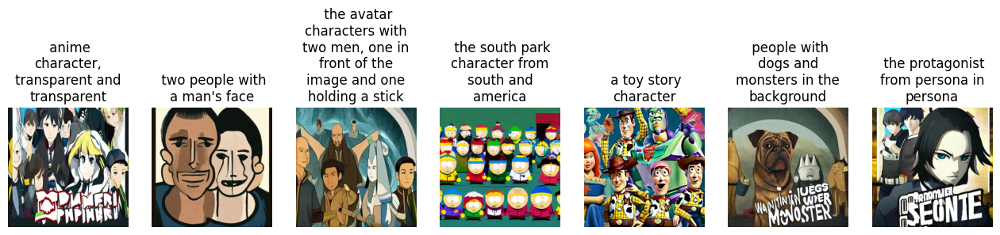

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


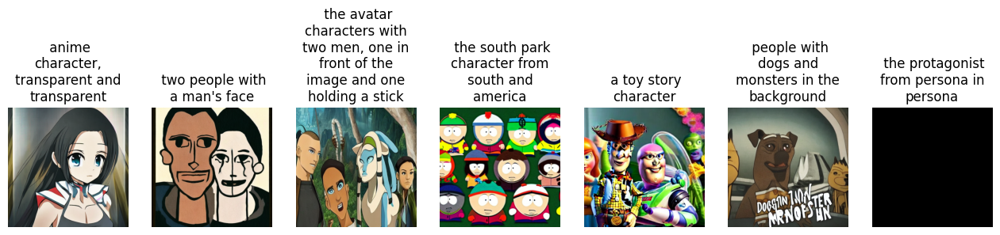

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


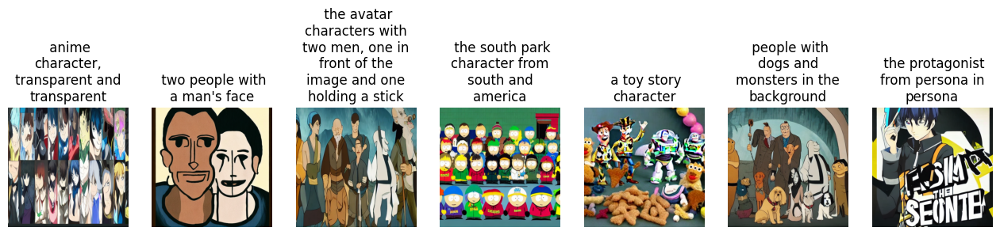

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


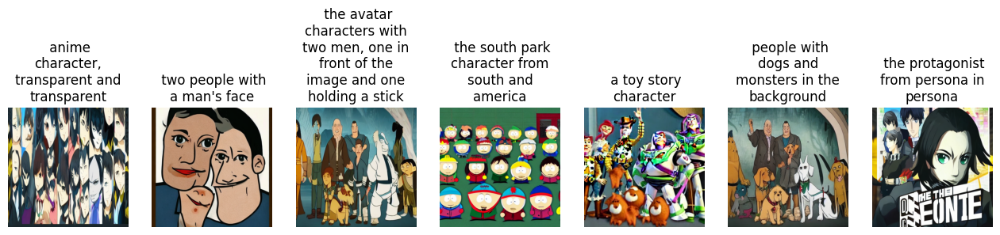

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


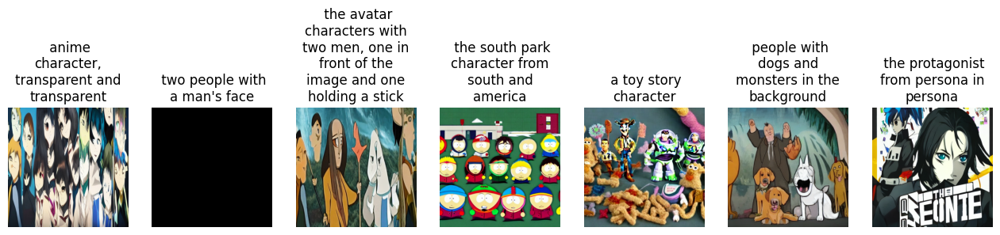

INFO:accelerate.accelerator:Saving current state to /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-5000
INFO:accelerate.checkpointing:Model weights saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-5000/pytorch_model.bin
INFO:accelerate.checkpointing:Optimizer state saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-5000/optimizer.bin
INFO:accelerate.checkpointing:Scheduler state saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-5000/scheduler.bin
INFO:accelerate.checkpointing:Sampler state for dataloader 0 saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-5000/sampler.bin
INFO:accelerate.checkpointing:Gradient scaler state saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-5000/scaler.pt
INFO:accelerate.checkpointing:Random states saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/sav

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


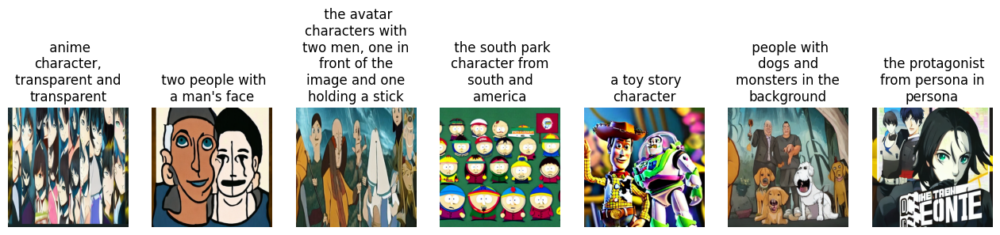

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


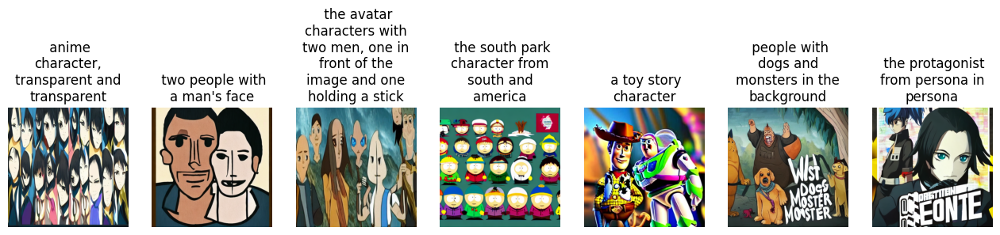

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


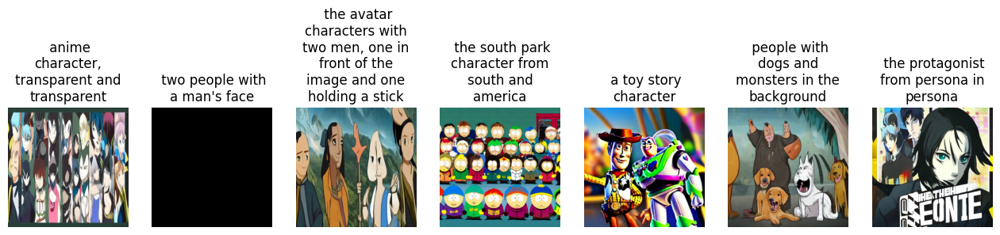

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


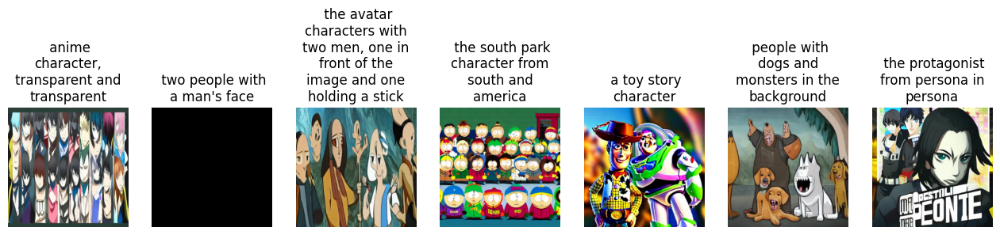

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


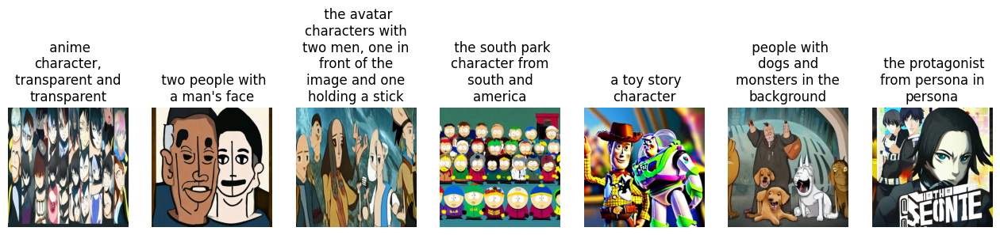

INFO:accelerate.accelerator:Saving current state to /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-7500
INFO:accelerate.checkpointing:Model weights saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-7500/pytorch_model.bin
INFO:accelerate.checkpointing:Optimizer state saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-7500/optimizer.bin
INFO:accelerate.checkpointing:Scheduler state saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-7500/scheduler.bin
INFO:accelerate.checkpointing:Sampler state for dataloader 0 saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-7500/sampler.bin
INFO:accelerate.checkpointing:Gradient scaler state saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-7500/scaler.pt
INFO:accelerate.checkpointing:Random states saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/sav

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


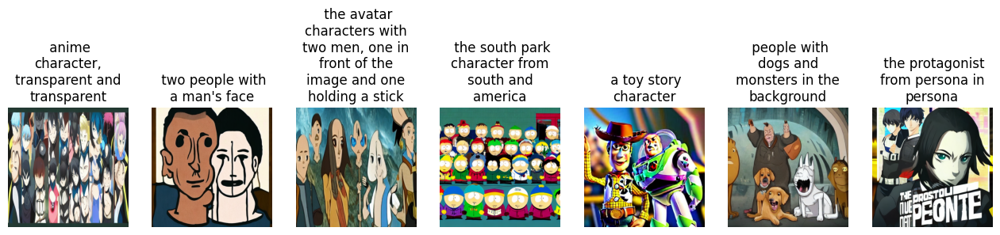

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


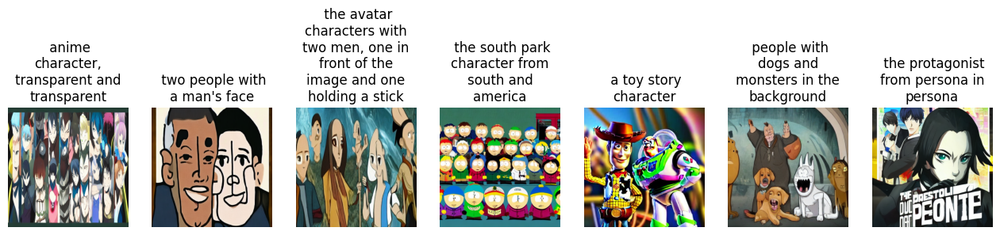

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


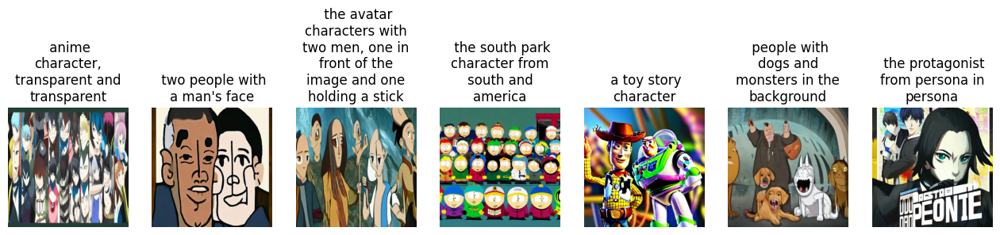

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


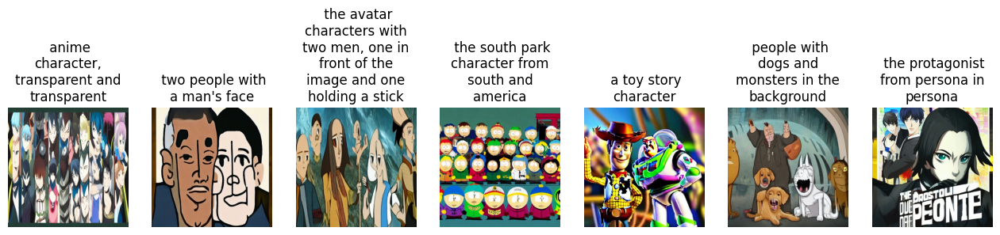

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


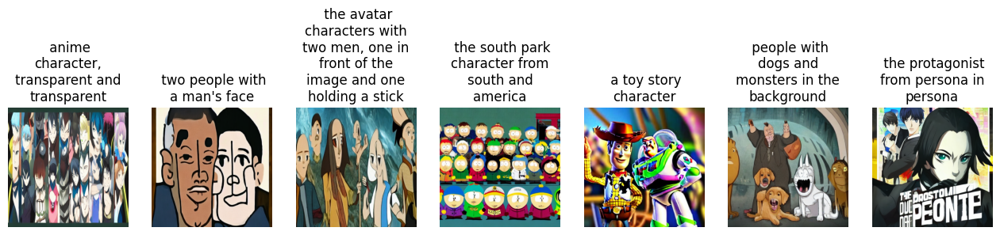

INFO:accelerate.accelerator:Saving current state to /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-10000
INFO:accelerate.checkpointing:Model weights saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-10000/pytorch_model.bin
INFO:accelerate.checkpointing:Optimizer state saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-10000/optimizer.bin
INFO:accelerate.checkpointing:Scheduler state saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-10000/scheduler.bin
INFO:accelerate.checkpointing:Sampler state for dataloader 0 saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-10000/sampler.bin
INFO:accelerate.checkpointing:Gradient scaler state saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW_2/save_1/checkpoint-10000/scaler.pt
INFO:accelerate.checkpointing:Random states saved in /content/drive/My Drive/Colab Notebooks/NewProject/HW

In [ ]:
# Главный цикл по эпохам
for epoch in range(first_epoch, ConfigOptions.num_train_epochs):
    unetModel.train().to(accel.device)  # Перенос модели на устройство
    train_loss = 0.0

    # Цикл по батчам
    for step, batch in enumerate(trainDataLoader):
        # Пропуск шагов до того момента, когда мы достигнем сохраненного шага
        if ConfigOptions.resume_from_checkpoint and epoch == first_epoch and step < resume_step:
            if step % ConfigOptions.gradient_accumulation_steps == 0:
                progress_bar.update(1)
            continue

        batch["pixel_values"] = batch["pixel_values"].to(accel.device, dtype=weightType)  # Перенос данных на устройство
        batch["input_ids"] = batch["input_ids"].to(accel.device)  # Перенос данных на устройство

        with accel.accumulate(unetModel):
            # Конвертация изображений в скрытое пространство
            vaeModel = vaeModel.to(accel.device)
            latents = vaeModel.encode(batch["pixel_values"]).latent_dist.sample()
            latents = latents * vaeModel.config.scaling_factor

            # Добавление шума к скрытым переменным
            noise = torch.randn_like(latents).to(accel.device)
            if ConfigOptions.noise_offset:
                noise += ConfigOptions.noise_offset * torch.randn(
                    (latents.shape[0], latents.shape[1], 1, 1), device=latents.device
                )

            # Выбор случайного временного шага для каждого изображения
            bsz = latents.shape[0]
            timesteps = torch.randint(0, noiseScheduler.config.num_train_timesteps, (bsz,), device=latents.device).long()

            # Добавление шума к скрытым переменным с учетом магнитуды шума на каждом временном шаге
            noisy_latents = noiseScheduler.add_noise(latents, noise, timesteps)

            # Получение текстового встраивания для условного моделирования
            textEncoder = textEncoder.to(accel.device)
            encoder_hidden_states = textEncoder(batch["input_ids"])[0]

            # Get the target for loss depending on the prediction type
            if ConfigOptions.prediction_type is not None:
                # set prediction_type of scheduler if defined
                noiseScheduler.register_to_config(prediction_type=ConfigOptions.prediction_type)

            if noiseScheduler.config.prediction_type == "epsilon":
                target = noise
            elif noiseScheduler.config.prediction_type == "v_prediction":
                target = noiseScheduler.get_velocity(latents, noise, timesteps)
            else:
                raise ValueError(f"Unknown prediction type {noiseScheduler.config.prediction_type}")

            # Предсказание шумового остатка и вычисление потерь
            model_pred = unetModel(noisy_latents, timesteps, encoder_hidden_states).sample

            if ConfigOptions.snr_gamma is None:
                loss = F.mse_loss(model_pred.float(), target.float(), reduction="mean")
            else:
                snr = compute_snr(timesteps)
                mse_loss_weights = (
                    torch.stack([snr, ConfigOptions.snr_gamma * torch.ones_like(timesteps)], dim=1).min(dim=1)[0] / snr
                )
                loss = F.mse_loss(model_pred.float(), target.float(), reduction="none")
                loss = loss.mean(dim=list(range(1, len(loss.shape)))) * mse_loss_weights
                loss = loss.mean()

            # Собрать потери со всех процессов для логирования
            avg_loss = accel.gather(loss.repeat(ConfigOptions.train_batch_size)).mean()
            train_loss += avg_loss.item() / ConfigOptions.gradient_accumulation_steps

            # Обратное распространение ошибки
            accel.backward(loss)
            if accel.sync_gradients:
                params_to_clip = lora_layers.parameters()
                accel.clip_grad_norm_(params_to_clip, ConfigOptions.max_grad_norm)
            optimizer.step()
            lr_scheduler.step()
            optimizer.zero_grad()

        # Обновление индикатора прогресса и глобального шага
        if accel.sync_gradients:
            progress_bar.update(1)
            global_step += 1

            train_loss = 0.0

            if global_step % ConfigOptions.checkpointing_steps == 0:
                if accel.is_main_process:
                    # Сохранение модели
                    save_path = os.path.join(ConfigOptions.outputDirectory, f"checkpoint-{global_step}")
                    accel.save_state(save_path)

        logs = {"step_loss": loss.detach().item(), "lr": lr_scheduler.get_last_lr()[0]}
        progress_bar.set_postfix(**logs)

        # Показать прогресс каждые N шагов
        if global_step % ConfigOptions.show_progress_step == ConfigOptions.show_progress_step-1:
            pipeline = DiffusionPipeline.from_pretrained(
                ConfigOptions.pretrained_model_name_or_path,
                unet=accel.unwrap_model(unetModel),
                revision=ConfigOptions.revision,
                torch_dtype=weightType,
            )
            pipeline = pipeline.to(accel.device)
            pipeline.set_progress_bar_config(disable=True)

            # Запустить вывод
            generator = torch.Generator(device=accel.device)
            checkModelState(pipeline, seed=ConfigOptions.seed)

            del pipeline
            torch.cuda.empty_cache()

        if global_step >= ConfigOptions.max_train_steps:
            break

In [ ]:
# Восстановление из контрольной точки, если указано
if ConfigOptions.resume_from_checkpoint:
    # Определяем, какую контрольную точку загрузить
    if ConfigOptions.resume_from_checkpoint != "latest":
        path = os.path.basename(ConfigOptions.resume_from_checkpoint)
    else:
        # Получаем самую последнюю контрольную точку
        dirs = os.listdir(ConfigOptions.output_dir)
        dirs = [d for d in dirs if d.startswith("checkpoint")]
        dirs = sorted(dirs, key=lambda x: int(x.split("-")[1]))
        path = dirs[-1] if len(dirs) > 0 else None

    # Загрузка контрольной точки или начало нового обучения
    if path is None:
        accel.print(f"Checkpoint '{ConfigOptions.resume_from_checkpoint}' does not exist. Starting a new training run.")
        ConfigOptions.resume_from_checkpoint = None
    else:
        accel.print(f"Resuming from checkpoint {path}")
        accel.load_state(os.path.join(ConfigOptions.output_dir, path))
        global_step = int(path.split("-")[1])

        resume_global_step = global_step * ConfigOptions.gradient_accumulation_steps
        first_epoch = global_step // num_update_steps_per_epoch
        resume_step = resume_global_step % (num_update_steps_per_epoch * ConfigOptions.gradient_accumulation_steps)

In [ ]:
# Дожидаемся всех процессов
accel.wait_for_everyone()

# Переносим модель UNet на устройство и сохраняем процессоры внимания
if accel.is_main_process:
    unetModel = unetModel.to(accel.device, dtype=torch.float32)
    unetModel.save_attn_procs(ConfigOptions.outputDirectory)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

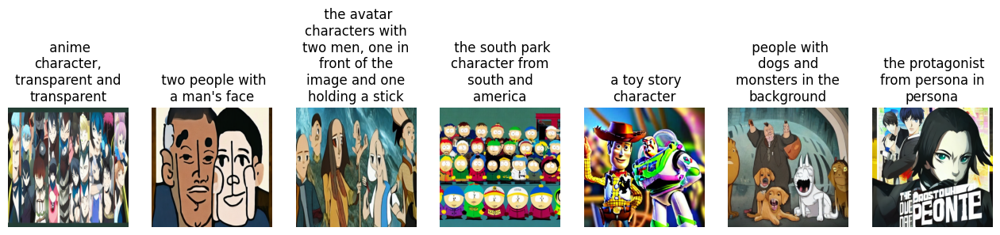

In [ ]:
# Инициализация модели диффузии и перенос на устройство
pipeline = DiffusionPipeline.from_pretrained(
    ConfigOptions.pretrained_model_name_or_path, revision=ConfigOptions.revision, torch_dtype=weightType
)
pipeline = pipeline.to(accel.device)

# Загрузка процессоров внимания
pipeline.unet.load_attn_procs(ConfigOptions.outputDirectory)

# Запуск вывода (инференса)
generator = torch.Generator(device=accel.device)
checkModelState(pipeline, seed=ConfigOptions.seed)

### [4 балла] Image Inpainting
В первой части задания (2 балла) вам предстоит обучить диффузионную модель решать задачу image inpainting. Для этого вам необходимо модифицировать код из семинара 2 следующий образом:
- Реализовать функцию генерации маски, можно использовать приведенную ниже или реализовать свою.
- Добавить в UNet новых 4 канала, куда подавать замаскированное изображение и маску
- Запустить обучение

---

**Ожидаемый результат**

В качестве результатов модели, от вас требуется предоставить визуализации генераций, полученных от вашей модели и код обучения модели.

# Импорт необходимых библиотек и зависимостей

In [1]:
%pip install -q -U einops datasets matplotlib tqdm boto3 git+https://github.com/dask/s3fs
%pip install diffusers["torch"] transformers

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 961.1 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 493.7/493.7 kB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 53.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.8/135.8 kB 13.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 14.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 15.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.0/302.0 kB 27.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.3/11.3 MB 63.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.8/79.8 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.5/73.5 kB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.4/166.4 kB 17.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.8/135.8 

In [2]:
import argparse
import hashlib
import itertools
import math
import os
import random
import requests
from io import BytesIO
from pathlib import Path
from dataclasses import dataclass

import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn.functional as F
import torch.utils.checkpoint

from accelerate import notebook_launcher
from accelerate import Accelerator
from accelerate.logging import get_logger
from accelerate.utils import ProjectConfiguration, set_seed

import PIL
from PIL import Image
from PIL import ImageDraw

from torch.utils.data import Dataset
from torchvision import transforms
from tqdm.auto import tqdm
from transformers import CLIPTextModel, CLIPTokenizer

from diffusers import AutoencoderKL
from diffusers import DDPMScheduler
from diffusers import StableDiffusionInpaintPipeline
from diffusers import StableDiffusionPipeline
from diffusers import UNet2DConditionModel

from diffusers.optimization import get_scheduler
from diffusers.utils import check_min_version

from datasets import load_dataset
from huggingface_hub import create_repo
from huggingface_hub import upload_folder
from huggingface_hub import notebook_login

notebook_login()

# Загрузка и разведочный анализ данных

In [3]:
# Загрузка датасета
dataset_raw = load_dataset("poloclub/diffusiondb", 'large_first_1k', split = 'train')

Generating train split: 0 examples [00:00, ? examples/s]

In [4]:
# Подготовка маски и изображения с маской
def prepare_image_and_mask(input_img, input_mask):
    # Преобразование изображения в тензор и нормализация
    img_tensor = np.array(input_img.convert("RGB"))
    img_tensor = img_tensor[None].transpose(0, 3, 1, 2)
    img_tensor = torch.from_numpy(img_tensor).to(dtype=torch.float32) / 127.5 - 1.0

    # Преобразование маски в тензор и установка пороговых значений
    mask_tensor = np.array(input_mask.convert("L"))
    mask_tensor = mask_tensor.astype(np.float32) / 255.0
    mask_tensor = mask_tensor[None, None]
    mask_tensor[mask_tensor < 0.5] = 0
    mask_tensor[mask_tensor >= 0.5] = 1
    mask_tensor = torch.from_numpy(mask_tensor)

    # Применение маски к изображению
    masked_img = img_tensor * (mask_tensor < 0.5)

    return mask_tensor, masked_img

# Создание случайной маски
def generate_random_mask(image_shape, coverage_ratio=1, mask_whole_image=False):
    # Создание новой маски с заданными размерами
    mask = Image.new("L", image_shape, 0)
    draw = ImageDraw.Draw(mask)

    # Расчет размера области маски
    mask_size = (random.randint(0, int(image_shape[0] * coverage_ratio)),
                 random.randint(0, int(image_shape[1] * coverage_ratio)))

    # Если необходимо, маска может покрывать всё изображение
    if mask_whole_image:
        mask_size = (int(image_shape[0] * coverage_ratio), int(image_shape[1] * coverage_ratio))

    # Расчет центра области маски
    mask_limits = (image_shape[0] - mask_size[0] // 2, image_shape[1] - mask_size[1] // 2)
    mask_center = (random.randint(mask_size[0] // 2, mask_limits[0]),
                   random.randint(mask_size[1] // 2, mask_limits[1]))

    # Выбор типа фигуры для маски: прямоугольник или эллипс
    shape_type = random.randint(0, 1)
    if shape_type == 0 or mask_whole_image:
        draw.rectangle(
            (mask_center[0] - mask_size[0] // 2, mask_center[1] - mask_size[1] // 2,
             mask_center[0] + mask_size[0] // 2, mask_center[1] + mask_size[1] // 2),
            fill=255,
        )
    else:
        draw.ellipse(
            (mask_center[0] - mask_size[0] // 2, mask_center[1] - mask_size[1] // 2,
             mask_center[0] + mask_size[0] // 2, mask_center[1] + mask_size[1] // 2),
            fill=255,
        )

    return mask

In [5]:
# Класс для подготовки данных для модели инпейнтинга (заполнение пропущенных областей изображения)
class InpaintData(Dataset):
    """
    Датасет для подготовки изображений и соответствующих им подсказок для дообучения модели.
    """

    def __init__(
        self,
        img_list,
        txt_tokenizer,
        img_prompt_list,
        img_size=512,
        use_center_crop=False,
    ):
        # Инициализация параметров
        self.img_size = img_size
        self.use_center_crop = use_center_crop
        self.txt_tokenizer = txt_tokenizer
        self.img_data_root = img_list
        self.img_list = [img for img in img_list]
        self.img_count = len(self.img_list)
        self.img_prompt_list = [prompt for prompt in img_prompt_list]
        self._dataset_size = self.img_count

        # Трансформации для изображений
        self.resize_and_crop_transforms = transforms.Compose(
            [
                transforms.Resize(img_size, interpolation=transforms.InterpolationMode.BILINEAR),
                transforms.CenterCrop(img_size) if use_center_crop else transforms.RandomCrop(img_size),
            ]
        )

        self.img_transforms = transforms.Compose(
            [
                transforms.ToTensor(),
                transforms.Normalize([0.5], [0.5]),
            ]
        )

    def __len__(self):
        return self._dataset_size

    # Получение элемента датасета по индексу
    def __getitem__(self, idx):
        sample_data = {}
        cur_img = self.img_list[idx % self.img_count]

        # Конвертация в RGB, если нужно
        if not cur_img.mode == "RGB":
            cur_img = cur_img.convert("RGB")

        cur_img = self.resize_and_crop_transforms(cur_img)

        sample_data["PIL_imgs"] = cur_img
        sample_data["tensor_imgs"] = self.img_transforms(cur_img)

        # Токенизация подсказки
        sample_data["prompt_token_ids"] = self.txt_tokenizer(
            self.img_prompt_list[idx % self.img_count],
            padding="max_length",
            truncation=True,
            max_length=self.txt_tokenizer.model_max_length,
        ).input_ids

        return sample_data

In [6]:
# Название и путь к предварительно обученной модели
pretrained_path = "CompVis/stable-diffusion-v1-4"

# Инициализация токенизатора
clip_tokenizer = CLIPTokenizer.from_pretrained(
    pretrained_path,
    subfolder="tokenizer",
)

In [7]:
# Инициализация датасета для обучения
train_data = InpaintData(
    img_list=dataset_raw['image'],
    txt_tokenizer=clip_tokenizer,
    img_prompt_list=dataset_raw['prompt'],
)

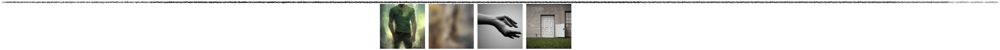

In [8]:
# Визуализация примеров из датасета
sample_count = 4
fig, axis_arr = plt.subplots(1, 4, figsize=(16, 4))
for i in range(sample_count):
    rnd_idx = random.choice(range(len(train_data)))
    axis_arr[i].imshow(train_data[rnd_idx]['tensor_imgs'].permute(1, 2, 0).numpy() / 2 + 0.5)
    img_title = clip_tokenizer.decode(train_data[rnd_idx]['prompt_token_ids'])
    img_title = img_title.strip()
    axis_arr[i].set_title(img_title)
    axis_arr[i].set_axis_off()
fig.tight_layout()
fig.show()

In [9]:
# Функция для подготовки батча данных
def prepare_batch(batch_examples):
    """
    Подготовка батча данных для тренировки модели.
    """
    # Извлечение необходимых данных
    token_ids = [example["prompt_token_ids"] for example in batch_examples]
    img_tensors = [example["tensor_imgs"] for example in batch_examples]

    # Списки для масок и маскированных изображений
    mask_list = []
    masked_img_list = []

    for example in batch_examples:
        pil_img = example["PIL_imgs"]
        # Генерация случайной маски
        generated_mask = generate_random_mask(pil_img.size, 1, False)
        # Подготовка маски и маскированного изображения
        cur_mask, cur_masked_img = prepare_image_and_mask(pil_img, generated_mask)

        mask_list.append(cur_mask)
        masked_img_list.append(cur_masked_img)

    # Преобразование в тензоры и конкатенация
    img_tensors = torch.stack(img_tensors)
    img_tensors = img_tensors.to(memory_format=torch.contiguous_format).float()

    token_ids = clip_tokenizer.pad({"input_ids": token_ids}, padding=True, return_tensors="pt").input_ids
    mask_tensors = torch.stack(mask_list)
    masked_img_tensors = torch.stack(masked_img_list)

    # Создание и возврат батча
    batch_data = {"input_ids": token_ids, "pixel_values": img_tensors,
                  "masks": mask_tensors, "masked_images": masked_img_tensors}

    return batch_data

In [10]:
# Класс для конфигурации параметров обучения
@dataclass
class TrainSettings:
    batch_sz = 1
    grad_accum_steps = 1
    max_train_steps = 30000
    learn_rate = 1e-5
    lr_warmup_steps = 500
    img_resolution = 512
    mixed_precision = "fp16"  # "no" для float32, "fp16" для автоматического смешанного режима
    output_folder = "inpaint"  # имя модели локально и на HF Hub
    rnd_seed = 3

# Инициализация параметров обучения
train_config = TrainSettings()

In [11]:
train_dataloader = torch.utils.data.DataLoader(
    train_data, batch_size=train_config.batch_sz, shuffle=True, collate_fn=prepare_batch
)

input_ids torch.Size([1, 77])
pixel_values torch.Size([1, 3, 512, 512])
masks torch.Size([1, 1, 1, 512, 512])
masked_images torch.Size([1, 1, 3, 512, 512])


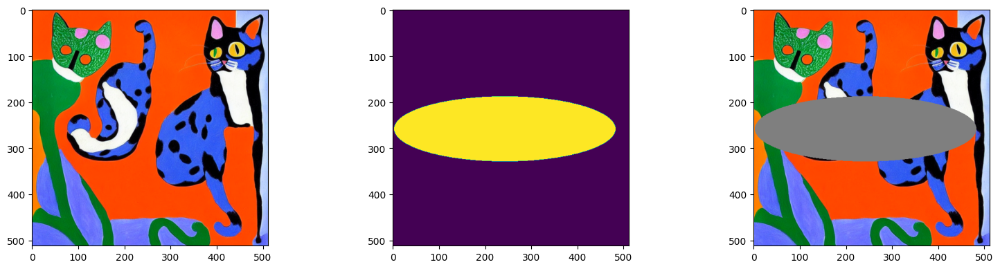

In [12]:
sample_image = next(iter(train_dataloader))

for k in sample_image:
    print(k, sample_image[k].shape)

fig, axs = plt.subplots(1, 3, figsize=(16, 4))

axs[0].imshow(sample_image['pixel_values'][0].permute(1, 2, 0).numpy() / 2 + 0.5)
axs[1].imshow(sample_image['masks'][0][0].permute(1, 2, 0).numpy() / 2 + 0.5)
axs[2].imshow(sample_image['masked_images'][0][0].permute(1, 2, 0).numpy() / 2 + 0.5)
fig.tight_layout()
fig.show()

# Построение модели

In [13]:
# Инициализация моделей
text_encoder_model = CLIPTextModel.from_pretrained('runwayml/stable-diffusion-inpainting', subfolder="text_encoder")
autoencoder_model = AutoencoderKL.from_pretrained('runwayml/stable-diffusion-inpainting', subfolder="vae")
unet_model = UNet2DConditionModel.from_pretrained(pretrained_path, subfolder="unet",
                                                  in_channels=9,
                                                  low_cpu_mem_usage=False,
                                                  ignore_mismatched_sizes=True,
                                                  use_safetensors=True
                                                 )

Some weights of UNet2DConditionModel were not initialized from the model checkpoint at CompVis/stable-diffusion-v1-4 and are newly initialized because the shapes did not match:
- conv_in.weight: found shape torch.Size([320, 4, 3, 3]) in the checkpoint and torch.Size([320, 9, 3, 3]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [14]:
# Выбор устройства для обучения (CPU или CUDA)
train_device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Инициализация расписания шума
noise_schedule = DDPMScheduler.from_pretrained(pretrained_path, subfolder="scheduler")

# Инициализация оптимизатора
optim_model = torch.optim.AdamW(
    unet_model.parameters(),  # оптимизация только весов сети
    lr=train_config.learn_rate,
)

In [15]:
# Функция для создания сетки изображений
def create_img_grid(image_list, row_count, col_count):
    """
    Создает сетку изображений из списка.
    """
    assert len(image_list) == row_count * col_count

    img_width, img_height = image_list[0].size
    grid_img = Image.new('RGB', size=(col_count * img_width, row_count * img_height))

    for i, single_img in enumerate(image_list):
        grid_img.paste(single_img, box=(i % col_count * img_width, i // col_count * img_height))
    return grid_img

In [16]:
# Функция для загрузки изображения по URL
def fetch_img(img_url):
    """
    Загружает изображение по заданному URL.
    """
    # Здесь предполагается, что requests и BytesIO уже импортированы
    response_data = requests.get(img_url)
    return PIL.Image.open(BytesIO(response_data.content)).convert("RGB")

In [17]:
# URL-адреса изображения и маски
img_link = "https://raw.githubusercontent.com/CompVis/latent-diffusion/main/data/inpainting_examples/6458524847_2f4c361183_k.png"
mask_link = "https://raw.githubusercontent.com/CompVis/latent-diffusion/main/data/inpainting_examples/6458524847_2f4c361183_k_mask.png"

# Загрузка и изменение размера изображений
initial_img = fetch_img(img_link).resize((512, 512))
initial_mask_img = fetch_img(mask_link).resize((512, 512))

# Инициализация ускорителя
acc_instance = Accelerator(
    mixed_precision=train_config.mixed_precision,
    gradient_accumulation_steps=train_config.grad_accum_steps,
    log_with="tensorboard",
    project_dir=os.path.join(train_config.output_folder, "logs")
)

In [19]:
# Инициализация конвейера для инпейнтинга
inpaint_pipeline = StableDiffusionInpaintPipeline.from_pretrained(
    'runwayml/stable-diffusion-inpainting',
    vae=acc_instance.unwrap_model(autoencoder_model),
    text_encoder=acc_instance.unwrap_model(text_encoder_model),
    tokenizer=clip_tokenizer,
    unet=acc_instance.unwrap_model(unet_model),
    safety_checker=None,
    torch_dtype=torch.float32,
)
inpaint_pipeline = inpaint_pipeline.to(train_device)

# Текстовая подсказка для инпейнтинга
inpaint_prompt = "a man standing and smoking a cigarette near a fence"

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_inpaint.StableDiffusionInpaintPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/50 [00:00<?, ?it/s]

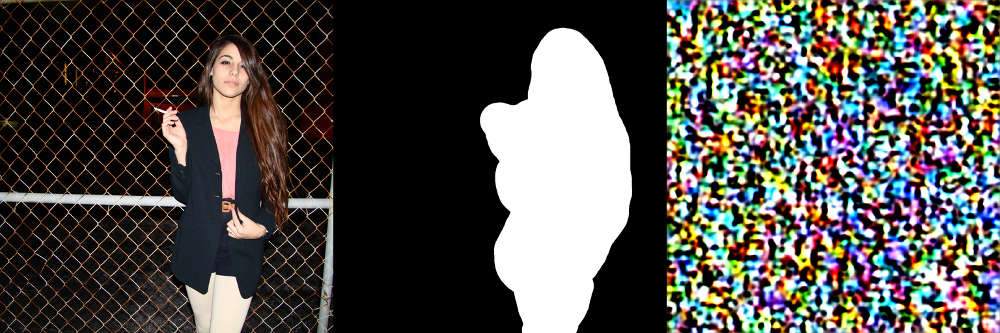

In [20]:
# Применение инпейнтинга
result_img = inpaint_pipeline(prompt=inpaint_prompt, image=initial_img, mask_image=initial_mask_img).images[0]

# Визуализация результатов
create_img_grid([initial_img, initial_mask_img, result_img], 1, 3)

In [21]:
# Основной цикл обучения
def training_cycle(train_config, unet_model, text_encoder_model, noise_schedule, optim_model, train_dataloader):
    """
    Функция для обучения модели.
    """
    # Инициализация ускорителя и логирования в Tensorboard
    acc_instance = Accelerator(
        mixed_precision=train_config.mixed_precision,
        gradient_accumulation_steps=train_config.grad_accum_steps,
        log_with="tensorboard",
        project_dir=os.path.join(train_config.output_folder, "logs")
    )

    # Подготовка моделей и оптимизатора
    unet_model, text_encoder_model, optim_model, train_dataloader = acc_instance.prepare(
        unet_model, text_encoder_model, optim_model, train_dataloader
    )

    # Перемещение моделей на устройство и установка типа данных
    dtype_weights = torch.float32
    autoencoder_model.requires_grad_(False)
    text_encoder_model.requires_grad_(False)
    text_encoder_model.to(train_device, dtype=dtype_weights)
    autoencoder_model.to(train_device, dtype=dtype_weights)

    unet_model.train()

    # Расчет числа шагов и эпох
    steps_per_epoch_1 = math.ceil(len(train_dataloader) / train_config.grad_accum_steps)

    # Добавленные строки
    if train_config.max_train_steps is None:
        train_config.max_train_steps = train_config.num_train_epochs * steps_per_epoch_1
        overrode_max_train_steps = True

    # Расчет числа шагов и эпох
    steps_per_epoch = math.ceil(len(train_dataloader) / train_config.grad_accum_steps)
    total_epochs = math.ceil(train_config.max_train_steps / steps_per_epoch_1)

    # Цикл обучения
    for epoch_num in range(total_epochs):
        epoch_loss = 0.0
        prog_bar = tqdm(range(len(train_dataloader)), disable=not acc_instance.is_local_main_process)
        prog_bar.set_description(f"Epoch {epoch_num} Steps:")

        for step_idx, batch_data in enumerate(train_dataloader):
            with acc_instance.accumulate(unet_model):
                dtype_weights = torch.float32
                # Конвертация изображений в скрытое пространство
                latents = autoencoder_model.encode(batch_data["pixel_values"].to(dtype=dtype_weights)).latent_dist.sample()
                latents = latents * autoencoder_model.config.scaling_factor

                # Конвертация маскированных изображений в скрытое пространство
                masked_latents = autoencoder_model.encode(
                    batch_data["masked_images"].reshape(batch_data["pixel_values"].shape).to(dtype=dtype_weights)
                ).latent_dist.sample()
                masked_latents = masked_latents * autoencoder_model.config.scaling_factor

                masks = batch_data["masks"]
                # Изменение размера маски, чтобы ее можно было объединить с latents
                mask = torch.stack(
                    [
                        torch.nn.functional.interpolate(mask, size=(train_config.img_resolution // 8, train_config.img_resolution // 8))
                        for mask in masks
                    ]
                )
                mask = mask.reshape(-1, 1, train_config.img_resolution // 8, train_config.img_resolution // 8)

                # Добавление шума к latents
                noise = torch.randn_like(latents)
                bsz = latents.shape[0]
                timesteps = torch.randint(0, noise_schedule.config.num_train_timesteps, (bsz,), device=latents.device)
                timesteps = timesteps.long()

                # Добавление шума к latents (это процесс прямого распространения)
                noisy_latents = noise_schedule.add_noise(latents, noise, timesteps)

                # Объединение шумных latents с маской и маскированными latents
                latent_model_input = torch.cat([noisy_latents, mask, masked_latents], dim=1)

                # Получение вложений текста для кондиционирования
                encoder_hidden_states = text_encoder_model(batch_data["input_ids"])[0]

                # Предсказание шумового остатка
                noise_pred = unet_model(latent_model_input, timesteps, encoder_hidden_states).sample

                # Получение цели для потерь в зависимости от типа предсказания
                target = noise

                # Расчет потерь
                loss = F.mse_loss(noise_pred.float(), target.float(), reduction="mean")

                acc_instance.backward(loss)
                optim_model.step()
                optim_model.zero_grad()

                prog_bar.update(1)
                logs = {"step_loss": loss.detach().item()}
                prog_bar.set_postfix(**logs)

In [22]:
# Запуск обучения с использованием notebook_launcher
train_args = (train_config, unet_model, text_encoder_model, noise_schedule, optim_model, train_dataloader)
notebook_launcher(training_cycle, train_args, num_processes=1, mixed_precision='fp16')

# Инициализация конвейера для инпейнтинга
inpaint_pipeline = StableDiffusionInpaintPipeline.from_pretrained(
    'runwayml/stable-diffusion-inpainting',
    autoencoder_model=acc_instance.unwrap_model(autoencoder_model),  # Используем распакованную модель autoencoder
    text_encoder=acc_instance.unwrap_model(text_encoder_model),  # Используем распакованную модель text_encoder
    tokenizer=clip_tokenizer,  # Используем токенизатор clip_tokenizer
    unet=acc_instance.unwrap_model(unet_model),  # Используем распакованную модель unet
    safety_checker=None,
    torch_dtype=torch.float32
)

# Перемещение конвейера на устройство обучения (CPU или CUDA)
inpaint_pipeline = inpaint_pipeline.to(train_device)

# Текстовый запрос для инпейнтинга
inpaint_prompt = "a man standing and smoking a cigarette near a fence"


Launching training on one GPU.


  0%|          | 0/1000 [00:00<?, ?it/s]

RuntimeError: ignored

  0%|          | 0/50 [00:00<?, ?it/s]

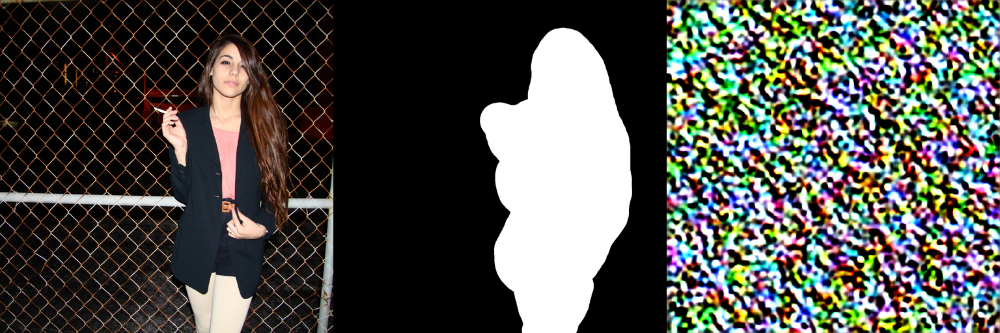

In [ ]:
# Применение инпейнтинга и получение результата
resultant_img = inpaint_pipeline(prompt=inpaint_prompt, image=initial_img, mask_image=initial_mask_img).images[0]

# Визуализация исходного изображения, маски и результата
create_img_grid([initial_img, initial_mask_img, resultant_img], 1, 3)

### Вывод:
Промпт не отработал в связи с ошикбой. К сожалению, лимит коллаба уже был исчерпан и ошибку выше победить не получилось:(

Во второй части задания (2 балла) вам предстоит провизуализировать результаты полученной модели inpainting и модели SD через [демо](https://colab.research.google.com/github/huggingface/notebooks/blob/main/diffusers/in_painting_with_stable_diffusion_using_diffusers.ipynb#scrollTo=R596bpT2ynqV). Пример демо реализован по ссылке. Если у вас не получится реализовать модель из первого задания, то вы можете использовать модель SD и получите один балл

**Ожидаемый результат**

От вас ожидается анализ кейсов, когда модель отрабатывает хорошо (например, определенный тип масок), а когда плохо.

In [26]:
# Количество выборок для отображения
num_disp_samples = 6
disp_images = []

# Отображение изображений из обучающего набора данных
for i in range(num_disp_samples):
    random_idx = random.choice(range(len(train_dataloader)))
    train_img = dataset_raw[random_idx]['image'].resize((512, 512))
    disp_images.append(train_img)

    # Генерация случайной маски
    train_mask_img = generate_random_mask(train_img.size, coverage_ratio=1, mask_whole_image=False).resize((512, 512))
    disp_images.append(train_mask_img)

    train_prompt = dataset_raw[random_idx]['prompt']
    inpainted_img = inpaint_pipeline(prompt=train_prompt, image=train_img, mask_image=train_mask_img).images[0]
    disp_images.append(inpainted_img)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

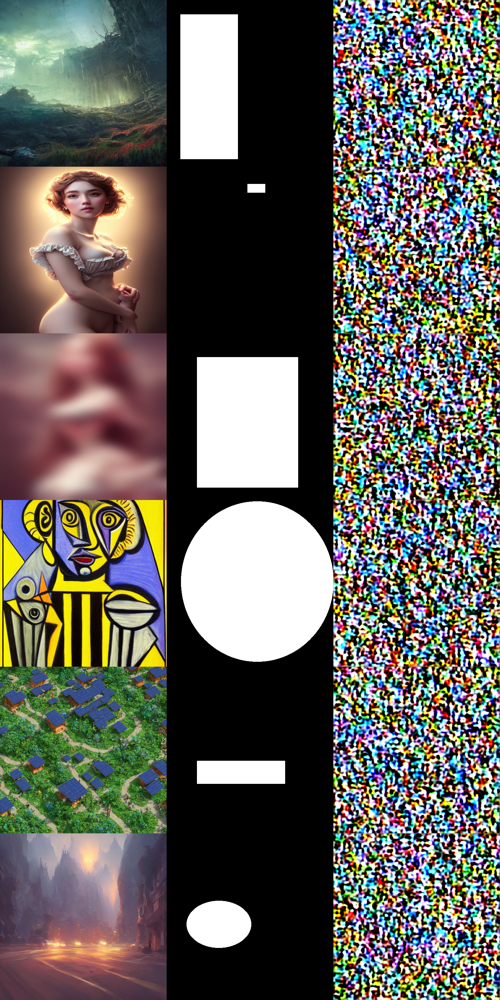

In [27]:
# Визуализация изображений
create_img_grid(disp_images, 6, 3)

In [28]:
# Загрузка валидационного набора данных
valid_data_set = load_dataset("playgroundai/blip_clipseg_inpainting_ip2p_data_test", split='train')

Extracting data files:   0%|          | 0/1 [00:00<?, ?it/s]

Generating train split:   0%|          | 0/825 [00:00<?, ? examples/s]

In [33]:
num_disp_samples = 6
disp_images = []
# Отображение изображений из валидационного набора данных
for i in range(num_disp_samples):
    random_idx = random.choice(range(len(valid_data_set)))
    valid_img = valid_data_set[random_idx]['og_image'].resize((512, 512))
    disp_images.append(valid_img)

    valid_mask_img = valid_data_set[random_idx]['mask'].resize((512, 512))
    disp_images.append(valid_mask_img)

    valid_prompt = valid_data_set[random_idx]['text']
    inpainted_img = inpaint_pipeline(prompt=valid_prompt, image=valid_img, mask_image=valid_mask_img).images[0]
    disp_images.append(inpainted_img)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

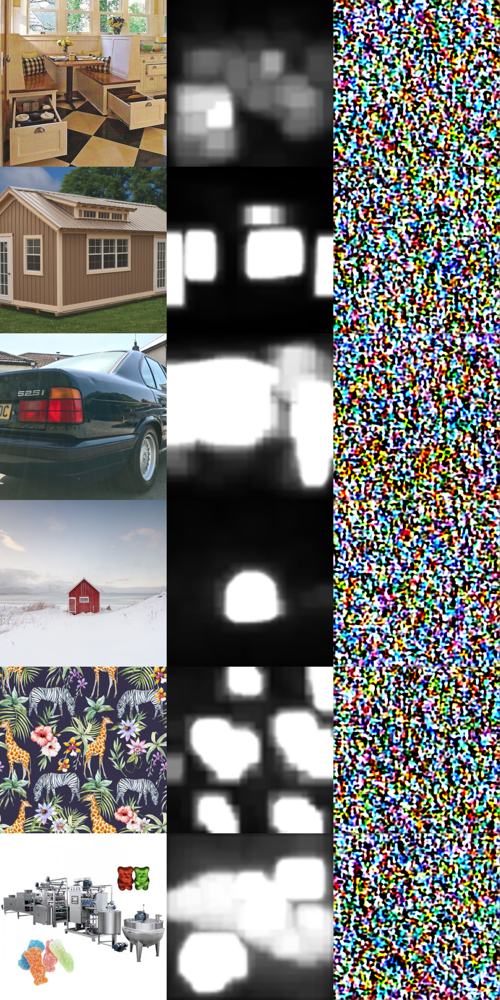

In [34]:
# Визуализация изображений
create_img_grid(disp_images, 6, 3)

К сожалению, из-за ошибки, с которой мы встретились выше с ней же мы столкнулись и в данном случае. Надеюсь на понимание проверяющих относительно ограниченности в ресурсах коллаба. 